# Estudo da canibalização de estabelecimentos

O desafio dado se encontra no repositório: https://github.com/kognitalab/kognita_exercicio_time_geo_v2/tree/master

**1. Definição do Problema:**
   - *Canibalização* ocorre quando a abertura ou proximidade de uma nova unidade de um negócio impacta negativamente o desempenho de unidades existentes, roubando clientes que, de outra forma, teriam visitado as outras unidades.
   - Neste caso, temos dados de localização de dispositivos móveis anonimizados, associados a eventos em estabelecimentos específicos. Queremos medir como a proximidade ou a concorrência entre unidades pode afetar a visitação.
   

**2. Premissas:**

- **Premissa 1: Representatividade dos dados:** Os dados de dispositivos móveis coletados são representativos do comportamento geral dos clientes que frequentam as lojas. Isso significa que a amostra de dispositivos móveis observados é suficientemente grande e diversificada para refletir os padrões de movimento e visitação de todos os clientes.

- **Premissa 2: Precisão da Geolocalização:** As coordenadas geográficas capturadas são precisas o suficiente para associar corretamente os dispositivos móveis às lojas visitadas. Se os dados de localização não forem precisos, pode haver erros na identificação de quais lojas foram visitadas, afetando a análise de fluxo.

- **Premissa 3: Intervalos de Tempo Adequados:** Os intervalos de tempo entre as observações de um dispositivo são curtos o suficiente para capturar mudanças relevantes de local (visitas entre lojas). Se o intervalo entre as observações for muito longo, movimentos importantes podem ser perdidos.

- **Premissa 4: Movimento Significativo:** Quando um dispositivo se move de uma loja para outra, esse movimento é significativo o suficiente para ser considerado uma troca de local que pode indicar canibalização. Pequenos movimentos que não refletem uma mudança real de preferência ou de consumo são ignorados.

- **Premissa 5: Estabilidade Temporal:** Os padrões de movimento observados durante o período de coleta de dados são estáveis e representativos do comportamento típico dos clientes. Se o período de coleta for atípico (por exemplo, durante um evento especial), os resultados podem não ser generalizáveis.


**3. Hipóteses:**

- **Hipótese 1: Canibalização Reflete-se no Movimento:** Se a canibalização estiver ocorrendo, ela se refletirá em um fluxo significativo de dispositivos móveis entre duas ou mais lojas. Ou seja, se muitos dispositivos que visitaram uma loja posteriormente visitam uma loja concorrente próxima, isso sugere canibalização.

- **Hipótese 2: Fluxo Direcional:** O fluxo de movimento entre lojas é direcional e pode indicar uma preferência ou uma mudança de comportamento do consumidor que pode ser atribuída à canibalização. Por exemplo, um fluxo maior de dispositivos movendo-se de uma loja para outra, mas não o contrário, pode indicar que a segunda loja está canibalizando a primeira.

- **Hipótese 3: Impacto Proporcional:** A magnitude da canibalização é proporcional ao número de dispositivos que se movem entre as lojas. Quanto mais dispositivos móveis fizerem essa transição, maior será o impacto da canibalização.

- **Hipótese 4: Independência de Fluxos:** Cada fluxo de movimento entre lojas é independente dos outros fluxos. Esta hipótese pode ser relaxada se houver evidências de que certos dispositivos têm padrões de movimento altamente correlacionados, o que pode requerer uma análise mais complexa.

- **Hipótese 5: Influência Geográfica:** A proximidade geográfica entre as lojas é um fator importante na canibalização, onde lojas mais próximas têm maior probabilidade de canibalizar clientes uma da outra do que lojas mais distantes.

**4. Estratégia de Análise:**

Irei realizar uma análise de Fluxo de Movimento que consiste em analisar os padrões de movimento dos consumidores entre lojas para detectar possíveis canibalizações.

Isso pode ser feito rastreando a origem e o destino dos consumidores com base em dados de mobilidade.

   - *Etapa 1: Estruturação dos dados:* O objetivo é mapear o fluxo de dispositivos entre as diferentes lojas. Isso envolve identificar sequências de visitas de um mesmo dispositivo a diferentes lojas.
   - *Etapa 2: Definir o fluxo de movimento:* O fluxo de movimento é definido como a transição de um dispositivo de uma loja para outra. Essa transição pode ser registrada cada vez que o dispositivo visita uma nova loja após uma visita anterior.
   - *Etapa 3: Análise de Canibalização:* Verifique se fluxos significativos entre lojas próximas sugerem que uma loja está canibalizando outra.
   - *Etapa 4: Quantificação da Canibalização:* A canibalização entre duas lojas AA e BB pode ser calculada como a proporção do fluxo de clientes que saem de AA e vão para BB em relação ao total de clientes que visitam BB.
   
   $Canibalização_{A\rightarrow B}=\frac{Fluxo\,de\,clientes\,de\,A\,para\,B}{Total\,clientes\,em\,B}$

## Importando das bibliotecas

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize
import seaborn as sns

import requests
import shapely
import shapely.geometry as geometry
from shapely.affinity import translate

import networkx as nx

import folium
from folium import Choropleth, Marker
from folium.plugins import HeatMap

from scipy.spatial import distance

import geopandas as gpd

## Análise exploratória de dados

In [2]:
df_est = pd.read_parquet("/content/drive/MyDrive/Kognita/estabelecimentos.parquet")

In [3]:
df_est.head(5)

,id_unidade,latitude,longitude
0,0,-22.8992,-47.0600
1,1,-22.8989,-47.0659
2,2,-22.8705,-47.0632
3,3,-22.9600,-47.0665
4,4,-22.9111,-47.0527


In [4]:
df_est.shape

(6, 3)

In [5]:
df_est.dtypes

,0
id_unidade,int64
latitude,float64
longitude,float64


In [6]:
df_footp = pd.read_parquet("/content/drive/MyDrive/Kognita/footprint.parquet")

In [7]:
df_footp

,id_dispositivo,latitude,longitude,date_hour,id_unidade
0,1825,-22.941824,-47.091248,2022-09-13 19:47:59,0
1,1748,-22.875540,-47.122768,2022-09-30 23:55:28,5
2,2303,-22.903105,-47.069195,2022-09-27 16:21:26,4
3,1208,-22.938639,-47.054867,2022-09-13 11:36:54,5
4,1929,-22.906368,-47.061615,2022-09-28 20:28:28,5
...,...,...,...,...,...
667880,248,-22.825764,-47.066708,2022-09-01 12:18:28,1
667881,2488,-22.908564,-47.066273,2022-09-30 21:28:10,4
667882,1623,-22.898991,-47.118462,2022-09-08 09:24:15,5
667883,1891,-22.904694,-47.058285,2022-09-22 08:10:22,4


In [8]:
df_footp.dtypes

,0
id_dispositivo,int64
latitude,float32
longitude,float32
date_hour,datetime64[ns]
id_unidade,int64


In [9]:
df_footp.describe()

,id_dispositivo,latitude,longitude,date_hour,id_unidade
count,667885.000000,667885.000000,667885.000000,667885,667885.000000
mean,1467.333424,-22.901327,-47.072594,2022-09-18 15:27:56.816147456,3.917462
min,0.000000,-23.056610,-47.245792,2022-09-01 00:00:05,0.000000
25%,1208.000000,-22.919025,-47.082619,2022-09-09 17:56:01,3.000000
50%,1574.000000,-22.901630,-47.063496,2022-09-21 13:54:27,5.000000
75%,1891.000000,-22.885530,-47.055790,2022-09-27 15:11:04,5.000000
max,2602.000000,-22.732430,-46.858051,2022-09-30 23:59:48,5.000000
std,599.624484,0.039724,0.031532,NaN,1.764795


In [10]:
df_footp.head(5)

,id_dispositivo,latitude,longitude,date_hour,id_unidade
0,1825,-22.941824,-47.091248,2022-09-13 19:47:59,0
1,1748,-22.875540,-47.122768,2022-09-30 23:55:28,5
2,2303,-22.903105,-47.069195,2022-09-27 16:21:26,4
3,1208,-22.938639,-47.054867,2022-09-13 11:36:54,5
4,1929,-22.906368,-47.061615,2022-09-28 20:28:28,5


In [11]:
df_footp.nunique()

,0
id_dispositivo,2603
latitude,86670
longitude,44519
date_hour,338613
id_unidade,6


## Preparação dos dados

Primeiro, vamos fazer o merge das duas bases de dados, com base no `id_unidade`:

In [12]:
df_base = df_footp.rename(columns={'latitude': 'latitude_dispositivo', 'longitude': 'longitude_dispositivo'}).merge(df_est.rename(columns={'latitude': 'latitude_poi', 'longitude': 'longitude_poi'}), on='id_unidade', how='left')

In [13]:
df_base.head(5)

,id_dispositivo,latitude_dispositivo,longitude_dispositivo,date_hour,id_unidade,latitude_poi,longitude_poi
0,1825,-22.941824,-47.091248,2022-09-13 19:47:59,0,-22.8992,-47.0600
1,1748,-22.875540,-47.122768,2022-09-30 23:55:28,5,-22.8999,-47.0582
2,2303,-22.903105,-47.069195,2022-09-27 16:21:26,4,-22.9111,-47.0527
3,1208,-22.938639,-47.054867,2022-09-13 11:36:54,5,-22.8999,-47.0582
4,1929,-22.906368,-47.061615,2022-09-28 20:28:28,5,-22.8999,-47.0582


In [14]:
df_base.shape

(667885, 7)

## Limpeza dos dados



*   Verificar dados faltantes e remover, caso o número de entradas seja pequeno
*   Verificação de outliers nas coordenadas geográficas



### Dados faltantes

In [15]:
# Verificar dados faltantes
print(df_base.isnull().sum())

id_dispositivo           0
latitude_dispositivo     0
longitude_dispositivo    0
date_hour                0
id_unidade               0
latitude_poi             0
longitude_poi            0
dtype: int64


### Limites do município de Campinas, SP

Irei utilizar a Nominatim API que é uma API gratuita do OpenStreetMap que permite fazer geocodificação reversa, além de buscar limites administrativos de locais. Assim, vamos buscar os limites geográficos da cidade de Campinas de São Paulo.

Depois, vou filtrar os eventos (estabelecimentos e dispositivos móveis) que se encontram dentro dessa região de interesse.

In [16]:
def get_city_polygon(city_name):
    headers = {
      'User-Agent': 'Mozilla/5.0 (compatible; YourAppName/1.0; +http://yourdomain.com)'
    }
    url = f'https://nominatim.openstreetmap.org/search?q={city_name}&format=json&polygon_geojson=1'
    response = requests.get(url, headers=headers)
    data = response.json()

    if len(data) > 0 and 'geojson' in data[0]:
        return data[0]['geojson']
    else:
        return None

In [17]:
city_name = 'Campinas,SP,Brazil'
campinas_polygon = get_city_polygon(city_name)

if campinas_polygon:
    print("Limites em GeoJSON:", campinas_polygon)
    #df_campinas_geom = gpd.GeoDataFrame({'geometry': [geometry.shape(polygon)]})
    #df_campinas_geom.set_crs(epsg=4326, inplace=True)
else:
    print("Não foi possível obter os limites.")

Limites em GeoJSON: {'type': 'Polygon', 'coordinates': [[[-47.2463023, -22.9099536], [-47.2462615, -22.9104816], [-47.2461623, -22.9108374], [-47.2457868, -22.9116527], [-47.2454425, -22.9123357], [-47.2449339, -22.9129769], [-47.2447783, -22.9131276], [-47.2445767, -22.913277], [-47.244077, -22.9136945], [-47.2438689, -22.9138378], [-47.2433835, -22.9141603], [-47.2431765, -22.9143765], [-47.2427103, -22.914886], [-47.242147, -22.9160046], [-47.2421162, -22.9161096], [-47.242092, -22.9161874], [-47.2420264, -22.9163097], [-47.241962, -22.9163851], [-47.2418989, -22.9164579], [-47.2418305, -22.9165085], [-47.2417782, -22.9165666], [-47.2417487, -22.9166754], [-47.2415843, -22.9167802], [-47.2414233, -22.9168098], [-47.2412758, -22.916795], [-47.2411819, -22.9168123], [-47.2410639, -22.9168443], [-47.2409392, -22.9168629], [-47.2408073, -22.9169483], [-47.2407313, -22.9170717], [-47.2406857, -22.9171507], [-47.2405596, -22.9171779], [-47.2403826, -22.9173113], [-47.2402378, -22.9175682]

In [18]:
# Converter o GeoJSON em um objeto Shapely para manipulação
municipio_shape = geometry.shape(campinas_polygon)

In [19]:
# Obter os limites do polígono (bounding box)
bounding_box = municipio_shape.bounds

In [20]:
# bounding_box retorna (min_lon, min_lat, max_lon, max_lat)
min_lon, min_lat, max_lon, max_lat = bounding_box

In [21]:
print(f"Limites do município de Campinas, SP:")
print(f"Latitude mínima: {min_lat}")
print(f"Latitude máxima: {max_lat}")
print(f"Longitude mínima: {min_lon}")
print(f"Longitude máxima: {max_lon}")

Limites do município de Campinas, SP:
Latitude mínima: -23.0612161
Latitude máxima: -22.7290463
Longitude mínima: -47.2463023
Longitude máxima: -46.8152838


In [22]:
df_filtered = df_base[(df_base['latitude_dispositivo'].between(min_lat, max_lat)) &
                         (df_base['longitude_dispositivo'].between(min_lon, max_lon))]

In [23]:
df_filtered = df_base[(df_base['latitude_poi'].between(min_lat, max_lat)) &
                         (df_base['longitude_poi'].between(min_lon, max_lon))]

In [24]:
df_filtered.shape

(667885, 7)

### Verificação de valores duplicados

In [25]:
print(df_filtered.duplicated().sum())

0


### Normalização de Timestamp

In [26]:
# Converter para datetime
df_filtered['date_hour'] = pd.to_datetime(df_filtered['date_hour'])

In [27]:
df_filtered['dia_da_semana'] = df_filtered['date_hour'].dt.day_name()
df_filtered['hora'] = df_filtered['date_hour'].dt.hour
df_filtered['dia_periodo'] = pd.cut(df_filtered['hora'], bins=[0, 6, 12, 18, 24],
                                    labels=['Madrugada', 'Manhã', 'Tarde', 'Noite'], right=False)

## Distribuições

### Distribuição do número de eventos por unidade

<ipython-input-28-4cd575189158>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_filtered, x='id_unidade', palette='Set3')


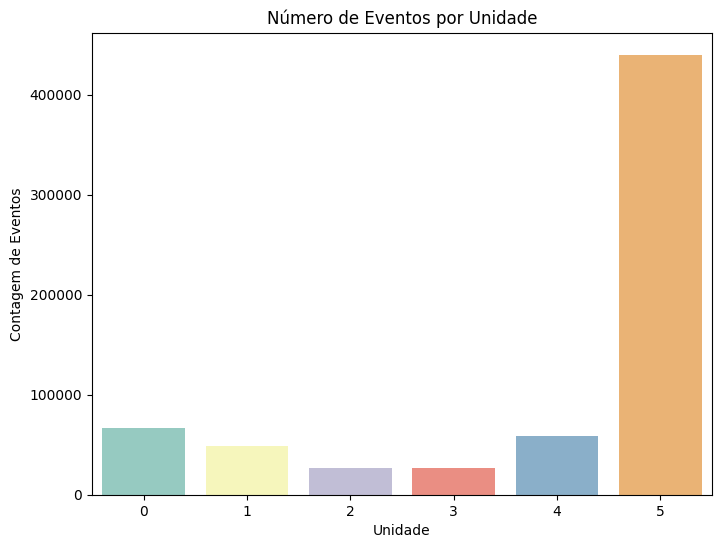

In [28]:
plt.figure(figsize=(8, 6))
sns.countplot(data=df_filtered, x='id_unidade', palette='Set3')
plt.title('Número de Eventos por Unidade')
plt.xlabel('Unidade')
plt.ylabel('Contagem de Eventos')
plt.show()

### Gráfico de série temporal

In [88]:
time_series = df_filtered.set_index('date_hour').groupby('id_unidade').resample('H').size().unstack(fill_value=0)

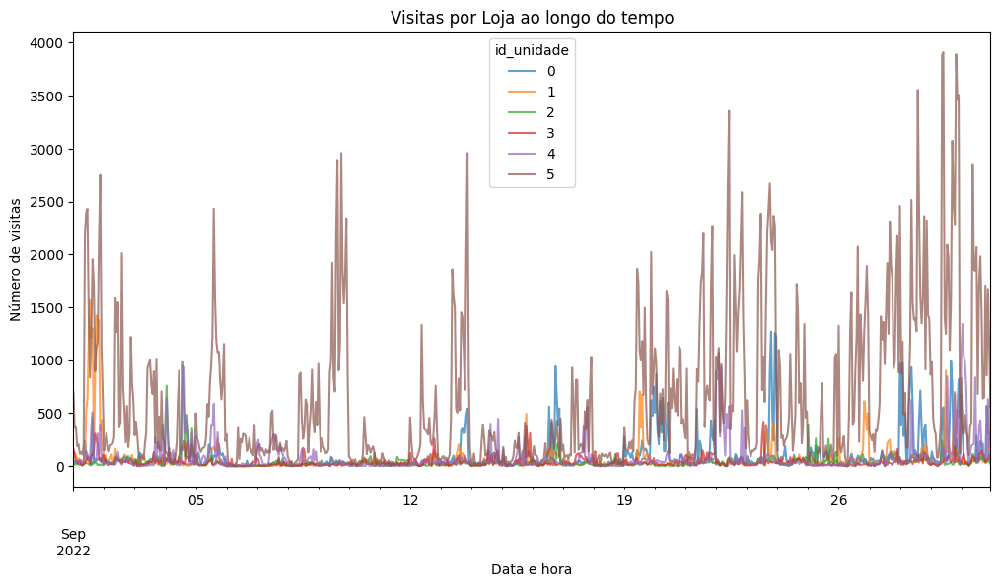

In [89]:
time_series.T.plot(figsize=(12, 6), alpha=0.7)
plt.title('Visitas por Loja ao longo do tempo')
plt.xlabel('Data e hora')
plt.ylabel('Número de visitas')
plt.show()

### Distribuição das visitas por unidades e horários

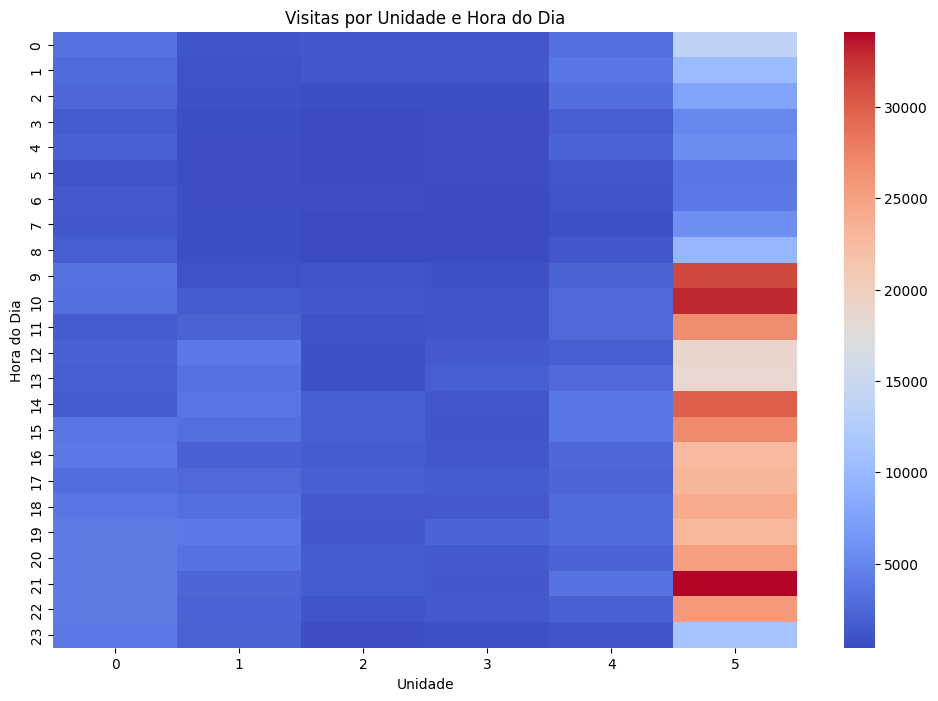

In [30]:
df_heatmap = df_filtered.groupby(['hora', 'id_unidade']).size().unstack().fillna(0)

plt.figure(figsize=(12, 8))
sns.heatmap(df_heatmap, cmap='coolwarm', annot=False)
plt.title('Visitas por Unidade e Hora do Dia')
plt.xlabel('Unidade')
plt.ylabel('Hora do Dia')
plt.show()

### Estudo de mobilidade

Quantas vezes cada dispositivo visitou cada loja?

In [70]:
visit_counts = df_filtered.groupby(['id_dispositivo','id_unidade']).size().reset_index(name='visit_count')

In [75]:
visit_counts

,id_dispositivo,id_unidade,visit_count
0,0,1,24
1,1,1,45
2,2,1,34
3,3,1,257
4,4,1,41
...,...,...,...
2750,2598,4,36
2751,2599,4,13
2752,2600,4,55
2753,2601,4,57


Quantos dispositivos visitaram somente uma loja?

In [90]:
exclusive_visits = visit_counts[visit_counts['visit_count'] == 1]

In [100]:
exclusive_visits

,id_dispositivo,id_unidade,visit_count
115,98,1,1
393,351,3,1
419,375,3,1
640,584,3,1
738,680,2,1
1422,1318,5,1
1533,1424,5,1
1767,1645,5,1
1799,1676,5,1
1990,1856,5,1


Quantos dispositivos visitaram mais de uma loja?

In [95]:
multiple_visits = visit_counts[visit_counts['visit_count'] > 1]

In [94]:
multiple_visits

,id_dispositivo,id_unidade,visit_count
0,0,1,24
1,1,1,45
2,2,1,34
3,3,1,257
4,4,1,41
...,...,...,...
2750,2598,4,36
2751,2599,4,13
2752,2600,4,55
2753,2601,4,57


## Identificação do Fluxo de movimento

- Ordenar os dados por dispositivo e timestamp
- Criar uma coluna de shift para capturar a unidade anterior visitada pelo dispositivo (fluxo de movimento)
- Filtrar apenas os fluxos válidos (onde o dispositivo mudou de loja)
- Contar a o movimento entre lojas


In [31]:
df_filtered = df_filtered.sort_values(by=['id_dispositivo', 'date_hour'])

In [32]:
df_filtered['previous_id_unidade'] = df_filtered.groupby('id_dispositivo')['id_unidade'].shift(1)

In [33]:
df_movements = df_filtered[df_filtered['id_unidade'] != df_filtered['previous_id_unidade']]

In [34]:
flow_counts = df_movements.groupby(['previous_id_unidade', 'id_unidade']).size().reset_index(name='count')

In [35]:
flow_counts

,previous_id_unidade,id_unidade,count
0,0.0,1,333
1,0.0,2,106
2,0.0,3,2
3,0.0,4,2
4,0.0,5,14642
5,1.0,0,341
6,1.0,2,2
7,1.0,4,109
8,1.0,5,2554
9,2.0,0,106


In [36]:
print(flow_counts['count'].describe())
print(flow_counts['count'].value_counts().sort_index())

count       27.000000
mean      1978.629630
std       4023.945979
min          1.000000
25%          2.500000
50%        160.000000
75%       2182.500000
max      14642.000000
Name: count, dtype: float64
count
1        3
2        4
3        1
4        1
106      2
108      1
109      1
160      1
162      1
333      1
341      1
500      1
509      1
2182     1
2183     1
2554     1
2562     1
6102     1
6105     1
14641    1
14642    1
Name: count, dtype: int64


## Visualização do Fluxo de Movimento

- Criar um grafo para visualizar o fluxo de movimento
- Adicionar arestas ao grafo com base nos fluxos entre as lojas
- Adicionar coordenadas das lojas como atributos dos nós
- Calcular a matriz de fluxo de movimento entre lojas
- Calcular a proporção de canibalização entre as lojas

In [37]:
G = nx.DiGraph()

In [38]:
for _, row in flow_counts.iterrows():
    G.add_edge(row['previous_id_unidade'], row['id_unidade'], weight=row['count'])

In [39]:
for _, row in df_filtered.drop_duplicates(subset=['id_unidade']).iterrows():
    G.nodes[row['id_unidade']]['pos'] = (row['longitude_poi'], row['latitude_poi'])

Obtendo as coordenadas dos nós

In [40]:
pos = nx.get_node_attributes(G, 'pos')

Obtendo os pesos das arestas

In [41]:
weights = nx.get_edge_attributes(G, 'weight')

In [42]:
flow_matrix = nx.to_pandas_adjacency(G, weight='weight')

In [43]:
flow_matrix

,0.0,1.0,2.0,3.0,4.0,5.0
0.0,0.0,333.0,106.0,2.0,2.0,14642.0
1.0,341.0,0.0,2.0,0.0,109.0,2554.0
2.0,106.0,1.0,0.0,0.0,2183.0,509.0
3.0,0.0,1.0,1.0,0.0,4.0,160.0
4.0,2.0,108.0,2182.0,3.0,0.0,6105.0
5.0,14641.0,2562.0,500.0,162.0,6102.0,0.0


### Calculando métricas de Teoria de Redes

- Grau: o grau de um nó em um grafo direcionado pode ser dividido em grau de entrada (número de arestas que chegam ao nó) e de saída (número de arestas que saem do nó).
- Centralidade:
  - de grau: mede a importância de um nó baseado no número de ligações que ele tem.
  - de proximidade: mede o quão próximo um nó está de todos os outros nós da rede.
  - de intermediação: mede quantas vezes um nó serve como ponto de passagem nas rotas mais curtas entre outros dois nós.
- Densidade: é a proporção entre o número de arestas existentes e o número máximo possível de arestas.

In [44]:
grau_entrada = dict(G.in_degree())
grau_saida = dict(G.out_degree())

In [45]:
print(f'Grau de entrada: {grau_entrada}')
print(f'Grau de saída: {grau_saida}')

Grau de entrada: {0.0: 4, 1.0: 5, 2.0: 5, 3.0: 3, 4.0: 5, 5.0: 5}
Grau de saída: {0.0: 5, 1.0: 4, 2.0: 4, 3.0: 4, 4.0: 5, 5.0: 5}


In [46]:
centralidade_grau = nx.degree_centrality(G)
centralidade_proximidade = nx.closeness_centrality(G)
centralidade_intermediacao = nx.betweenness_centrality(G)

In [47]:
print(f'Centralidade de grau: {centralidade_grau}')
print(f'Centralidade de proximidade: {centralidade_proximidade}')
print(f'Centralidade de intermediação: {centralidade_intermediacao}')

Centralidade de grau: {0.0: 1.8, 1.0: 1.8, 2.0: 1.8, 3.0: 1.4000000000000001, 4.0: 2.0, 5.0: 2.0}
Centralidade de proximidade: {0.0: 0.8333333333333334, 1.0: 1.0, 2.0: 1.0, 3.0: 0.7142857142857143, 4.0: 1.0, 5.0: 1.0}
Centralidade de intermediação: {0.0: 0.03333333333333333, 1.0: 0.0125, 2.0: 0.0125, 3.0: 0.0, 4.0: 0.04583333333333334, 5.0: 0.04583333333333334}


In [48]:
densidade = nx.density(G)

In [49]:
print(f'Densidade do grafo: {densidade}')

Densidade do grafo: 0.9


Com base nas métricas apresentadas, podemos tirar as seguintes conclusões sobre a rede de lojas em termos de canibalização e influência:

1. **Grau de Entrada e Grau de Saída**
   - **Grau de Entrada**: Representa o número de fluxos de clientes que chegam a cada loja.
     - Lojas com grau de entrada maior (5) são **Lojas 1, 2, 4, e 5**, o que indica que essas lojas estão recebendo clientes de várias outras lojas, sugerindo uma forte atratividade ou centralidade.
     - Loja 3 tem o menor grau de entrada (3), indicando que recebe menos clientes de outras lojas.

   - **Grau de Saída**: Representa o número de fluxos de clientes que saem de cada loja.
     - Lojas com grau de saída maior (5) são **Lojas 0, 4, e 5**, indicando que essas lojas estão perdendo clientes para várias outras lojas, o que pode indicar uma grande influência, mas também um risco de alta canibalização.
     - Loja 1 e 2 têm graus de saída ligeiramente menores (4), sugerindo que podem estar retendo clientes melhor ou têm menos interações com outras lojas.

2. **Centralidade de Grau**
   - **Lojas 4 e 5** têm a maior centralidade de grau (2.0), indicando que estão muito conectadas com outras lojas, seja recebendo ou enviando clientes. Isso pode significar que são as lojas mais influentes ou mais afetadas na rede.
   - **Lojas 0 e 1** têm centralidades de grau médias (1.8), indicando que, apesar de serem importantes, não são tão centrais quanto Lojas 4 e 5.
   - **Loja 3** tem a menor centralidade de grau (1.4), sugerindo uma menor importância relativa na rede, com menos conexões com outras lojas.

3. **Centralidade de Proximidade**
   - **Lojas 1, 2, 4, e 5** têm centralidade de proximidade de 1.0, indicando que essas lojas estão mais próximas de todas as outras na rede, ou seja, qualquer cliente pode passar rapidamente de uma loja para outra, o que pode aumentar o risco de canibalização.
   - **Loja 0** tem uma centralidade de proximidade um pouco menor (0.833), e **Loja 3** tem a menor (0.714), indicando que estas lojas são menos acessíveis ou menos centrais na rede.

4. **Centralidade de Intermediação**
   - **Lojas 4 e 5** têm a maior centralidade de intermediação (~0.0458), indicando que atuam como "pontes" cruciais entre outras lojas, desempenhando um papel importante na transferência de clientes e, potencialmente, na canibalização entre lojas.
   - **Loja 0** também tem alguma centralidade de intermediação (0.0333), sugerindo que também é uma ponte significativa, mas em menor grau.
   - **Lojas 1, 2 e 3** têm pouca ou nenhuma centralidade de intermediação, indicando que não desempenham um papel significativo como pontes na rede.

5. **Densidade do Grafo**
   - **Densidade do Grafo: 0.9**: Essa é uma densidade muito alta, indicando que a maioria das lojas está conectada à maioria das outras lojas. Isso sugere que há um alto nível de interação entre as lojas, o que pode exacerbar a canibalização, pois os clientes têm muitas opções e podem facilmente mudar de uma loja para outra.

**Conclusões Gerais**
   - **Lojas 4 e 5** são as mais centrais e influentes na rede, tanto em termos de grau como de intermediação. Essas lojas são mais suscetíveis a canibalizar outras e serem canibalizadas devido à sua alta conectividade.
   - **Loja 3** é a menos conectada e central, o que pode significar que está menos envolvida em dinâmicas competitivas ou que pode estar em uma localização menos estratégica.
   - A **alta densidade** da rede sugere que há um risco geral elevado de canibalização, com muitas lojas competindo pelos mesmos clientes.

Essas métricas indicam que, para mitigar a canibalização, pode ser necessário focar em estratégias para diversificar a oferta de produtos, alterar o posicionamento das lojas ou ajustar o marketing para minimizar a sobreposição de clientes entre essas lojas centrais e as outras.


### Visualização do grafo

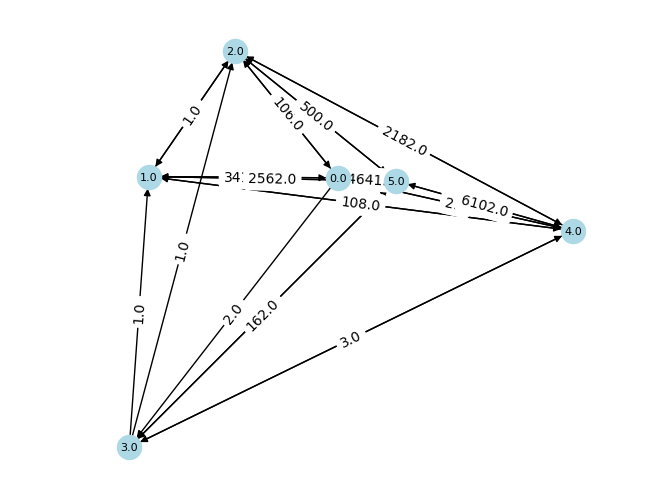

In [50]:
nx.draw(G, pos, with_labels=True, node_color='lightblue', font_size=8)
nx.draw_networkx_edge_labels(G, pos, edge_labels={(u, v): d['weight'] for u, v, d in G.edges(data=True)})
plt.show()

In [51]:
for u, v, data in G.edges(data=True):
    print(f"Direção: Loja {u} -> Loja {v}")
    print(f"Magnitude (Peso): {data['weight']}")
    print("-" * 40)

Direção: Loja 0.0 -> Loja 1.0
Magnitude (Peso): 333.0
----------------------------------------
Direção: Loja 0.0 -> Loja 2.0
Magnitude (Peso): 106.0
----------------------------------------
Direção: Loja 0.0 -> Loja 3.0
Magnitude (Peso): 2.0
----------------------------------------
Direção: Loja 0.0 -> Loja 4.0
Magnitude (Peso): 2.0
----------------------------------------
Direção: Loja 0.0 -> Loja 5.0
Magnitude (Peso): 14642.0
----------------------------------------
Direção: Loja 1.0 -> Loja 0.0
Magnitude (Peso): 341.0
----------------------------------------
Direção: Loja 1.0 -> Loja 2.0
Magnitude (Peso): 2.0
----------------------------------------
Direção: Loja 1.0 -> Loja 4.0
Magnitude (Peso): 109.0
----------------------------------------
Direção: Loja 1.0 -> Loja 5.0
Magnitude (Peso): 2554.0
----------------------------------------
Direção: Loja 2.0 -> Loja 0.0
Magnitude (Peso): 106.0
----------------------------------------
Direção: Loja 2.0 -> Loja 1.0
Magnitude (Peso): 1.0
-

In [52]:
def classificar_canibalizacao(peso, loja_origem, loja_destino):
    # Avalie a canibalização com base no peso e nos limites calculados
    if peso > 10000:
        conclusao = f"A Loja {loja_origem} exerce uma forte canibalização sobre a Loja {loja_destino} com um peso de {peso}."
    elif peso > 1000:
        conclusao = f"A Loja {loja_origem} exerce uma canibalização significativa sobre a Loja {loja_destino} com um peso de {peso}."
    elif peso > 10:
        conclusao = f"A Loja {loja_origem} exerce uma canibalização moderada sobre a Loja {loja_destino} com um peso de {peso}."
    else:
        conclusao = f"A Loja {loja_origem} exerce uma canibalização leve sobre a Loja {loja_destino} com um peso de {peso}."

    return conclusao

In [53]:
# Iteração sobre as arestas do grafo G
for u, v, data in G.edges(data=True):
    peso = data['weight']

    conclusao = classificar_canibalizacao(peso, u, v)

    # Imprime a conclusão
    print(conclusao)

A Loja 0.0 exerce uma canibalização moderada sobre a Loja 1.0 com um peso de 333.0.
A Loja 0.0 exerce uma canibalização moderada sobre a Loja 2.0 com um peso de 106.0.
A Loja 0.0 exerce uma canibalização leve sobre a Loja 3.0 com um peso de 2.0.
A Loja 0.0 exerce uma canibalização leve sobre a Loja 4.0 com um peso de 2.0.
A Loja 0.0 exerce uma forte canibalização sobre a Loja 5.0 com um peso de 14642.0.
A Loja 1.0 exerce uma canibalização moderada sobre a Loja 0.0 com um peso de 341.0.
A Loja 1.0 exerce uma canibalização leve sobre a Loja 2.0 com um peso de 2.0.
A Loja 1.0 exerce uma canibalização moderada sobre a Loja 4.0 com um peso de 109.0.
A Loja 1.0 exerce uma canibalização significativa sobre a Loja 5.0 com um peso de 2554.0.
A Loja 2.0 exerce uma canibalização moderada sobre a Loja 0.0 com um peso de 106.0.
A Loja 2.0 exerce uma canibalização leve sobre a Loja 1.0 com um peso de 1.0.
A Loja 2.0 exerce uma canibalização significativa sobre a Loja 4.0 com um peso de 2183.0.
A Loj

Na figura temos os nós (lojas) e as arestas com os seus pesos, que significam o número de dispositivos que se moveram entre as lojas.

Com base nos pesos e direções das arestas entre as lojas, podemos tirar várias conclusões sobre a canibalização e as dinâmicas entre as lojas. Vamos analisar as principais observações:

1. **Loja 5 como Loja Dominante**
   - **Pesos Altos de Arestas que Saem da Loja 5**:
     - A Loja 5 canibaliza fortemente a Loja 0 com um peso de `14641.0`, que é o maior valor observado.
     - Também exerce forte canibalização sobre a Loja 4 (`6102.0`) e a Loja 1 (`2562.0`).
   - **Pesos Altos de Arestas que Entram na Loja 5**:
     - A Loja 5 recebe muitos clientes da Loja 0 (`14642.0`), indicando que há uma troca intensa de clientes entre estas duas lojas.
     - Recebe também clientes significativos da Loja 4 (`6105.0`) e da Loja 1 (`2554.0`).

   **Conclusão**: A Loja 5 é um centro de convergência e um dominante na rede, tanto atraindo quanto perdendo muitos clientes para e de outras lojas, especialmente Loja 0 e Loja 4. Essa loja está em uma posição muito competitiva e pode estar centralizando a maior parte dos clientes.

2. **Loja 0 como Importante Competidora**
   - **Pesos Moderados em Arestas que Saem da Loja 0**:
     - A Loja 0 canibaliza a Loja 1 (`333.0`) e, mais significativamente, a Loja 5 (`14642.0`).
   - **Pesos Moderados em Arestas que Entram na Loja 0**:
     - Loja 0 recebe clientes principalmente da Loja 5 (`14641.0`), e em menor grau da Loja 1 (`341.0`).

   **Conclusão**: A Loja 0 é um importante competidor no cenário, com um fluxo significativo de clientes trocando com a Loja 5. Ela canibaliza e é canibalizada, especialmente pela Loja 5.

3. **Loja 4 Como Competidora Notável**
   - **Pesos Altos em Arestas que Saem da Loja 4**:
     - A Loja 4 canibaliza a Loja 2 (`2182.0`) e Loja 5 (`6105.0`).
   - **Pesos Altos em Arestas que Entram na Loja 4**:
     - Ela também perde muitos clientes para a Loja 5 (`6102.0`) e recebe clientes da Loja 2 (`2183.0`).

   **Conclusão**: Loja 4 é uma competidora de destaque, com um fluxo significativo de clientes indo e vindo principalmente entre as Lojas 2 e 5. Sua relação com a Loja 5 sugere uma dinâmica competitiva muito intensa.

4. **Lojas com Baixo Impacto (Loja 2 e Loja 3)**
   - **Pesos Relativamente Baixos**:
     - As Lojas 2 e 3 têm pesos menores em suas arestas, indicando uma canibalização menos intensa e, possivelmente, menos influência no cenário geral.

   **Conclusão**: Lojas 2 e 3 parecem ser menos influentes no cenário geral, com menor intensidade de canibalização, especialmente se comparadas a Lojas 0, 4, e 5.

5. **Análise da Canibalização Global**
   - **Relações de Força**:
     - A Loja 5 aparece como a mais dominante, possivelmente exercendo uma forte atração sobre clientes que poderiam frequentar outras lojas, o que pode prejudicar as performances das outras lojas.
     - As interações entre Lojas 0, 4 e 5 destacam que a canibalização é mais intensa nessas lojas, indicando que elas estão em competição direta e que suas localizações e ofertas de produtos ou serviços podem ser muito similares.

**Conclusão Final**: A Loja 5 é a loja mais canibalizadora e canibalizada, especialmente em relação às Lojas 0 e 4. Se todas essas lojas pertencem à mesma rede, a canibalização entre elas pode estar prejudicando a rede como um todo. Estratégias para reduzir a sobreposição de clientes, como diversificação de produtos, ofertas, ou mesmo reconsideração de localização, poderiam ser exploradas para mitigar esses efeitos.

## Análise de Canibalização - Análise de Sobreposição:

Vamos calcular uma métrica de canibalização, como a proporção de dispositivos que visitaram uma loja antes de se moverem para outra loja concorrente próxima.

In [54]:
canibalizacao = {node: sum(weights.get((node, neighbor), 0) for neighbor in G.neighbors(node)) for node in G.nodes}

In [55]:
canibalizacao_prop = flow_matrix.div(flow_matrix.sum(axis=1), axis=0)

In [56]:
canibalizacao_prop

,0.0,1.0,2.0,3.0,4.0,5.0
0.0,0.000000,0.022075,0.007027,0.000133,0.000133,0.970633
1.0,0.113440,0.000000,0.000665,0.000000,0.036261,0.849634
2.0,0.037871,0.000357,0.000000,0.000000,0.779921,0.181851
3.0,0.000000,0.006024,0.006024,0.000000,0.024096,0.963855
4.0,0.000238,0.012857,0.259762,0.000357,0.000000,0.726786
5.0,0.610882,0.106897,0.020862,0.006759,0.254600,0.000000


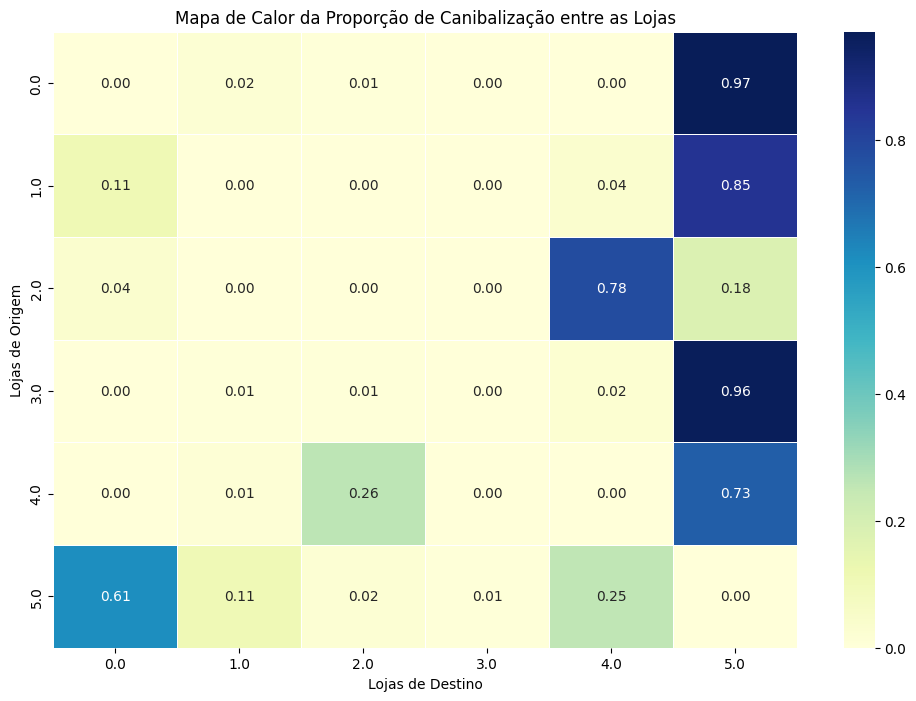

In [57]:
plt.figure(figsize=(12, 8))
sns.heatmap(canibalizacao_prop, annot=True, cmap="YlGnBu", fmt=".2f", linewidths=.5)
plt.title("Mapa de Calor da Proporção de Canibalização entre as Lojas")
plt.xlabel("Lojas de Destino")
plt.ylabel("Lojas de Origem")
plt.show()

## Criação do mapa

Vamos criar o mapa centrado em Campinas, SP, e adicionar as seguintes informações:
- nós: localização das lojas
- arestas: fluxo de movimento dos dispositivos móveis onde a espessura representa o volume de dispositivos se movendo entre as lojas
- mapa de calor: mostrando a densidade de dispositivos móveis, logo, as áreas com maior movimento de dispositivos serão destacadas com maior intensidade no mapa
- polígonos: representando a área de canibalização das lojas. Os polígonos são centrados nas lojas e o tamanho é proporcional à canibalização de uma loja sobre a outra. Esta informação é adicionada como uma camada no mapa.


In [58]:
def get_color(value, cmap='YlOrRd'):
    """ Obtém a cor com base no valor e no mapa de cores """
    norm = Normalize(vmin=0, vmax=1)
    colormap = cm.get_cmap(cmap)
    return cm.colors.rgb2hex(colormap(norm(value)))

In [59]:
# Adicionar os nós (lojas) ao mapa
def add_nodes_to_map(m, G):
    for node, data in G.nodes(data=True):
        folium.Marker(
            location=[data['pos'][1], data['pos'][0]],
            popup=f'Loja {node}',
            icon=folium.Icon(color='blue')
        ).add_to(m)

In [79]:
def create_polygon(center, radius):
    """ Cria um polígono circular aproximado com um dado raio e centro """
    circle = geometry.Polygon([(np.cos(theta) * radius + center[0], np.sin(theta) * radius + center[1]) for theta in np.linspace(0, 2 * np.pi, 30)])
    return circle

In [101]:
def add_canibalizacao_layers(m, pos, canibalizacao_prop, size_scale=0.05):
    """ Adiciona camadas individuais ao mapa com base na canibalização """
    for node, (lat, lon) in pos.items():
        feature_group = folium.FeatureGroup(name=f'Canibalização de {node}')
        canib_values = canibalizacao_prop.loc[node]
        for target_node, prop in canib_values.items():
            if prop > 0:
                target_pos = pos[target_node]
                # Distância proporcional baseada na canibalização
                prop_distance = prop * size_scale
                # Criar um polígono centrado na loja
                polygon = create_polygon((lat, lon), prop_distance)
                # Obter a cor baseada na intensidade de canibalização
                color = get_color(prop)
                # Adicionar o polígono ao FeatureGroup
                folium.Polygon(
                    locations=[(y, x) for x, y in polygon.exterior.coords],
                    color=color,
                    fill=True,
                    fill_color=color,
                    fill_opacity=0.5,
                    popup=f'Canibalização de {node} para {target_node}: {prop:.2f}'
                ).add_to(feature_group)
        feature_group.add_to(m)

In [62]:
def add_edges_to_map(m, G):
    """ Adiciona arestas ao mapa com base no peso """
    # Normalizar os pesos
    weights = [data['weight'] for u, v, data in G.edges(data=True)]
    max_weight = max(weights)
    min_weight = min(weights)

    for u, v, data in G.edges(data=True):
        point1 = G.nodes[u]['pos']
        point2 = G.nodes[v]['pos']
        if point1 != point2:  # Certificar que as coordenadas sejam diferentes
            normalized_weight = (data['weight'] - min_weight) / (max_weight - min_weight)
            folium.PolyLine(
                locations=[(point1[1], point1[0]), (point2[1], point2[0])],
                color='green',
                tooltip=f'Loja {u} -> Loja {v}: peso: {data["weight"]}',
                weight=2 + normalized_weight * 8,  # Ajuste do peso com normalização
                opacity=0.6
            ).add_to(m)

In [68]:
heat_data = [[row['latitude_dispositivo'], row['longitude_dispositivo']] for index, row in df_filtered.iterrows()]

In [102]:
m = folium.Map(location=[-23.5505, -46.6333], zoom_start=13)

In [103]:
HeatMap(heat_data, radius=15).add_to(m)

In [104]:
# Adicionar círculos de canibalização e arestas ao mapa
add_nodes_to_map(m, G)
add_canibalizacao_layers(m, pos, canibalizacao_prop)
add_edges_to_map(m, G)

<ipython-input-58-2afd566cc8b3>:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = cm.get_cmap(cmap)


In [105]:
# Adicionar o controle de camadas (se você estiver usando múltiplas camadas)
folium.LayerControl().add_to(m)

In [108]:
m.save('mapa_campinas_canibalizacao_grafo.html')

In [107]:
m